# Advanced Cryptography
### Alessandro Bruni/9th March 2020/IT-University of Copenhagen

Back in 2018...
![Moden cryptography](https://imgs.xkcd.com/comics/2018.png)
*<https://xkcd.com/1935>

# Plan for this lecture

- RSA encryption
- RSA digital signatures and certificates
- 1-2 oblivious transfer
- Pedersen commitments

In [1]:
import itertools, math, random
from matplotlib import pyplot as plt
import numpy as np

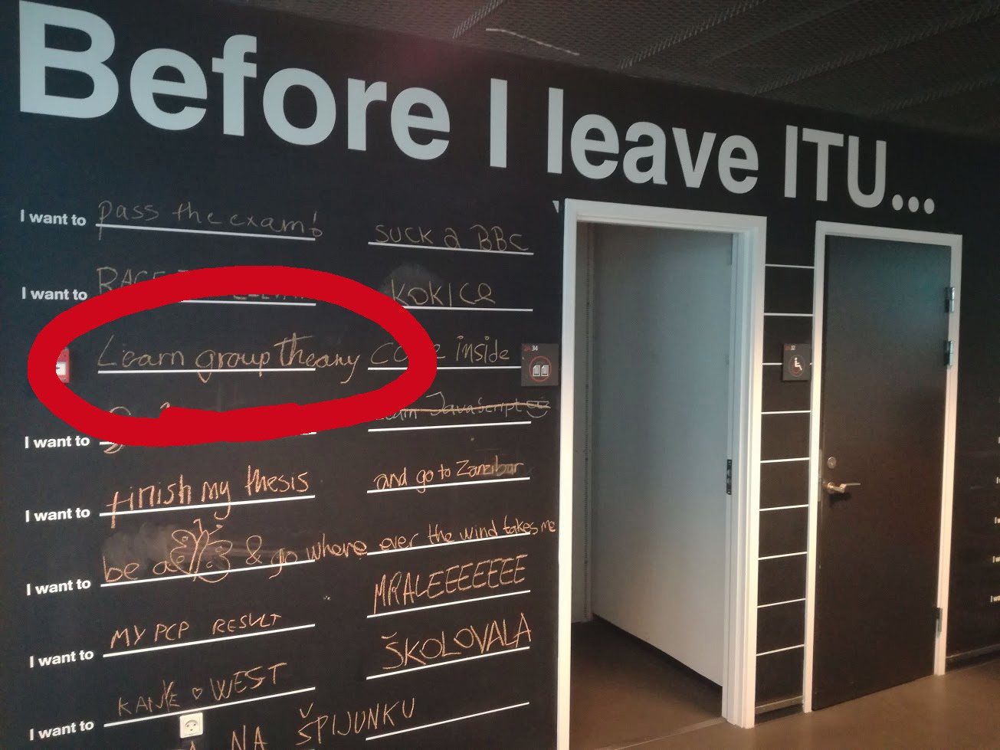

# Generating random primes

**Bertrand’s postulate:** For any $n>1$, the fraction of $n$-bit integers that are prime is at least $1/3n$.

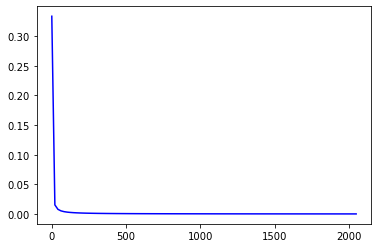

0.00016276041666666666


In [2]:
n = np.linspace(1,2048,100); plt.plot(n, 1/(3*n),'b'); plt.show(); print(1/(3*2048))

If we set the number of tries $t = 3n^2$ then the probability that we don't find an $n$-bit prime is:

$\left(1-{1\over 3n}\right)^t = \left(\left(1-{1\over 3n}\right)^{3n}\right)^n \le (e^{-1})^n = e^{-n}$

So for $1024$ bits we have $3\cdot 1024^2 = 3145728$ tries.

In [3]:
def gen_prime(n):
 for i in range(1, 3*n**2):
  p = 2**(n-1) | random.getrandbits(n-2)<<1 | 1
  if prime_test(p, n): return p

# Group theory

**Lemma 8.37**  Let $\mathbb H$ be a strict subgroup of a finite group $\mathbb G$ (i.e. $\mathbb H \subset \mathbb G$). Then $|\mathbb H| \le |\mathbb G|/2$.

**Theorem 8.38** Fix $N$. Say there exists a witness that $N$ is composite. Then at least half of the elements of $\mathbb Z_N^*$ are witnesses that $N$ is composite.

This tells us that if there is an element that is not a generator...

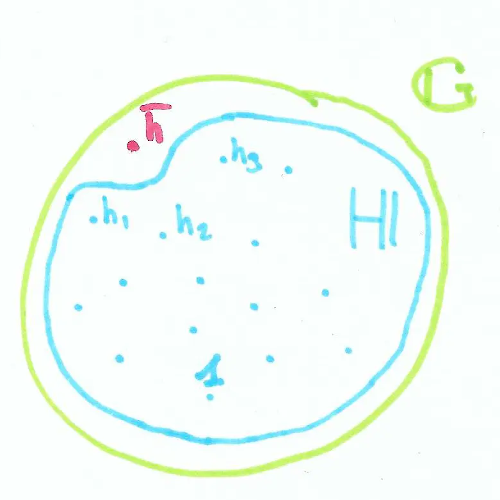

...then at least half the elements are not generators!

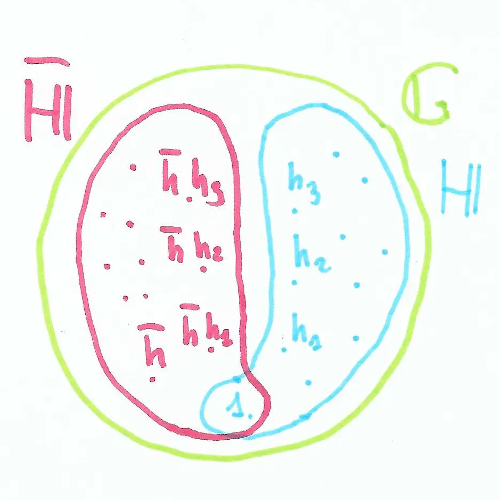

(and thus witnesses that $N$ is not prime for $\mathbb Z_N^*$)

# Primality testing (1st attempt)

- If $N$ is prime, then we know that $|\mathbb Z_N^*| = N-1$
- Then $a^{N-1} = 1 \mod N$ for all $a \in \{1\ldots N-1\}$
- So we can **hope** to find an $a$ such that $a^{N-1} \neq 1 \mod N$

In [4]:
def prime_test(N, t):
 for i in range(1, t+1):
  a = random.randint(1, N-1)
  if pow(a, N-1, N) != 1: return False
 return True

prime_test(2018, 12)

False

Pheeew...

# Miller-Rabin primality test

There are some composites, called *Carmichael numbers*, for which the previous test always fails.
Miller-Rabin is a more refined test that works on these too.

In [6]:
def prime_test(N, t):
 r, u = 1, (N-1)>>1
 while u%2 == 0:
  r, u = r+1, u>>1
 for j in range(1, t+1):
  a = random.randint(1, N-1)
  if (not(pow(a, u, N) in [1, N-1])
      and all(pow(a, u<<i, N) != N-1 for i in range(1, r))):
   return False
 return True

print(gen_prime(1024))

129959381739245485257776409031406132579068068514363239230514551297553260916858100171814290640123292192734036601485374294636207665385807608000534657124030483938983016320381725774479385430522056167498812748018828440589016904594115377181332474625915407069172730139248670508116552591224712854813412230681604892311


# GenModulus

Generates an integer $N$ which is the product of two primes $p$ and $q$.

In [8]:
def gen_modulus(n):
 p = gen_prime(n)
 q = gen_prime(n)
 N = p*q
 return N, p, q

N, p, q = gen_modulus(512)
print('N =', N, '\np =', p, '\nq =', q)

N = 97728410942323480073646136131232486589905164591561132354235791826522263098554731174719218274126418384394175213419661229856757142784875736799457807052555057342436079209078418723780667783212682553266753820005796391857529600802898850310488286144329736063149827810767471349077984922549036032952166181565418690517 
p = 9310707629734975400051176672170845047337351636805509302033069157228005064537779195987341508838543916005547301488345704953370820984333971107018523060789491 
q = 10496346231538286422874596246457063070917419800020739816938657396010170470136531318305168441118211651018029616927193064271850972782793437959063514101732887


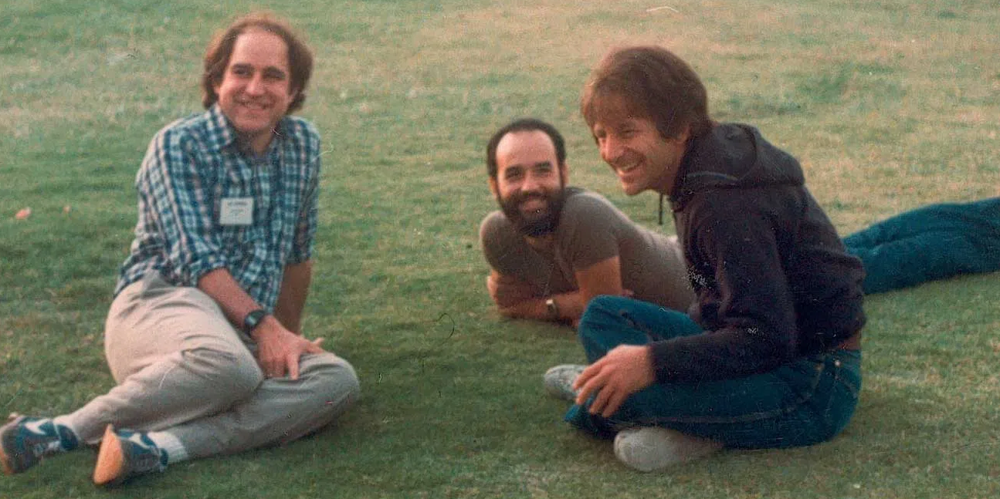

# RSA, finally!

- Choose $N = p\cdot q$ for $p,q$ primes.
- Choose an integer $e>2$ co-prime with $\phi(N) = (p-1)\cdot(q-1)$.
- Compute $d = e^{-1} \mod \phi(N)$.

In [11]:
def egcd(a, b):
    s = 0; s1 = 1
    t = 1; t1 = 0
    r = b; r1 = a
    while r != 0:
        q = r1//r
        r1, r = r, r1 - q*r
        s1, s = s, s1 - q*s
        t1, t = t, t1 - q*t
    return (r1, s1, t1)

def modinv(a, m):
 g, x, y = egcd(a, m)
 if g == 1: return x % m

log_2 = lambda c: next(filter(lambda x: 2**x > c, itertools.count()))

In [7]:
def gen_RSA(n):
 N, p, q = gen_modulus(n)
 Φ_N = (p-1) * (q-1)
 for e in [3, 65537]:
  if e < Φ_N and math.gcd(e, Φ_N) == 1:
   d = modinv(e, Φ_N)
   return N, e, d

# RSA encryption & decryption

- To encrypt a message $m$ compute $c = m^e \mod N$
- To decrypt a ciphertext $c$ compute $m = c^d \mod N$

In [9]:
rsa_encrypt = lambda m, pk: pow(m, pk['e'], pk['N'])
rsa_decrypt = lambda c, sk: pow(c, sk['d'], sk['N'])

# Example

In [12]:
N,e,d = gen_RSA(512)
pk = {'N': N, 'e': e}
sk = {'N': N, 'e': e, 'd': d}
print(N, e, d)

71100885626883594404973364118050351580429459968513220996149614210139836275609155031761483147096510992304386948269906042867763985181692782810632449799749805973028698372574059549369552790686574274142748614948478031802420744658059264584828150125868997778654817650321860838939077856683491501286559318482931278883 65537 34040808830351199195032565511574620161727499968445905903477218137411807724183109654570396214450573346438420270623691073852355624502891106493266618511173064433227665198436668664214748725509689792793523942494167831986229517389899815293822013365986708085198512760803875055636601602538993391997856854544026932873


In [13]:
c = rsa_encrypt(20, pk)
m = rsa_decrypt(c, sk)
print('c =', c, '\nm =', m)

c = 22764871540526848650234483458536645927216772368518389331590799668631134073488389287709021786974816074639156682743953530435136549162316580196626457137832123474980752526729754714172895335727821325415022836618015950871119319426157109251235877654930315923758674678660863425125305560078628863088333023480728900030 
m = 20


# Attacks on RSA

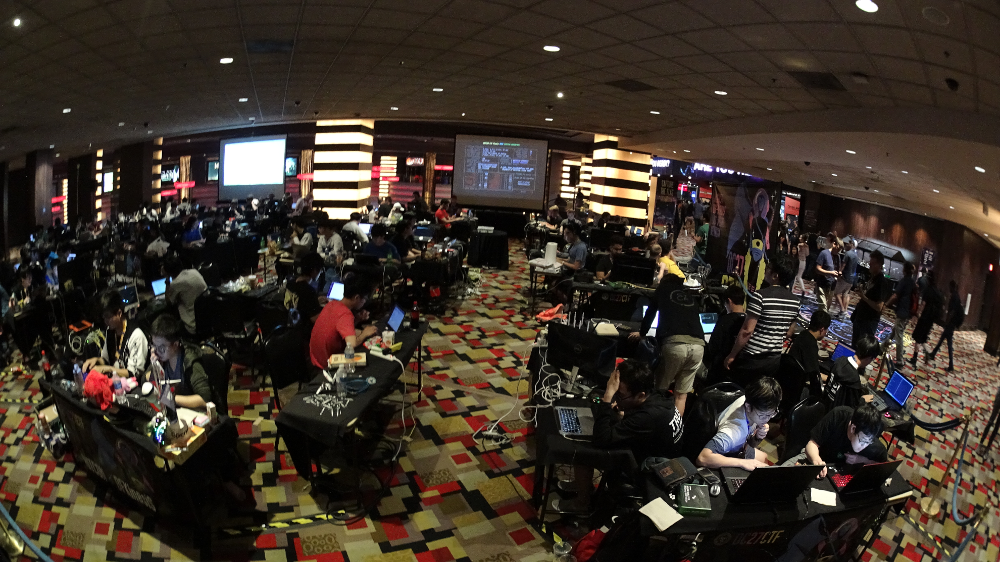

# The RSA function is *completely deterministic* $\to$ not CPA-secure

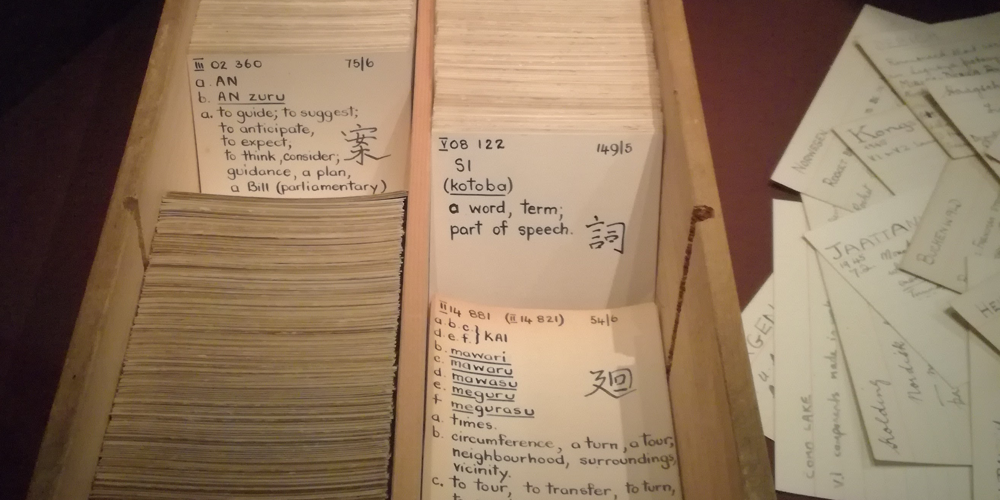

# Encrypting short messages using small $e$

- With low exponent (typically $e = 3$) and small messages (e.g. $m$ with less than $N/3$ bits) then $m^3 \mod N = m^3$
- $log_3(m)$ is easy to compute (look Pollard's Rho algorithm)
- This means that if $N$ is $1024$ bits, we can easily attack any message $m$ with $\approx 300$ bits.
- That includes an AES-256 bit key if we wanted to encode it with plain RSA

# A quadratic improvement in recovering $m$

- If we know that $m < B$, we can do a brute-force attack in $\mathcal O(B)$
- But we can also recover $m$ with high probability in time $\mathcal O(\sqrt B)$
- If $m$ is composite, there exists $r \cdot s = m$ with $1<r\le \sqrt m$
- So we choose our guess $n$ of bits for the plaintext, and $\alpha \in ({1 \over 2}, 1)$.
- Then we try to find $r, s$, with $1<r\le s\le 2^{\alpha n}$ for which $m = r \cdot s$
- If so, then $r^e \cdot s^e = (r \cdot s)^e = m^e = c$
- We can split this search if we precompute $x_r = c/r^e = s^e \mod N$

## Quadratic reduction algorithm

In [15]:
def recover_message(pk, c, n, α):
    N, e = pk['N'], pk['e']
    T = int(2**(α*n))
    print('T =', T)
    pairs = {}
    for r in range(1, T):
        x_r = c * modinv(pow(r, e, N), N) % N
        pairs[x_r] = r
    for s in range(1, T):
        r = pairs.get(pow(s, e, N))
        if r:
            print('r =', r, 's =', s)
            return r * s % N

## Example recovery

In [16]:
n = 25
m = random.getrandbits(n)
c = rsa_encrypt(m, pk)
print('m =', m, '\nc =', c)
recover_message(pk, c, n, 0.6)

m = 11391055 
c = 44556678880667595140462647567869157357318383332510834851241735622080020966362134214122561341165859012104456786332794711613016220108823437849600096801726788217697039702363945744633534081180154069276307814469281064220282629876664577225780269138207784493045047031256420533549880684059275698022810465908846728003
T = 32768
r = 30215 s = 377


11391055

# More attacks on textbook RSA

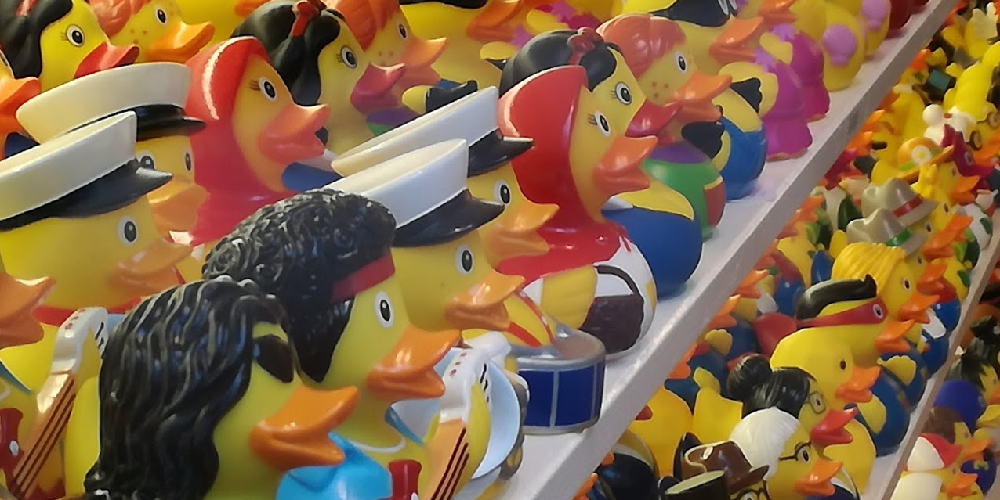

### Encrypting a partially known message
- Assume $e = 3$ and that you have $m = m_1 || m_2$ and know $m_1$. You can express $m$ also as $m = 2^k \cdot m_1 + m_2$ for $k = |m_1|$.
- Then $c = m^3 \mod N = (m_1 || m_2)^3 \mod N$
- We can express the problem of finding $m_2$ as the root of a cubic polynomial $p(x) = (2^k\cdot m_1 + x)^3 - c$, which can be solved in polynomial time.

### Encrypting related messages
- Assume $m$ and $m + \delta$ encrypted with the same key:
  
  $c_1 = m^3 \mod N$, $c_2 = (m+\delta)^e \mod N$
- Then we can construct the two polynomials:

  $f_1(x) = x^e - c_1$ and $f_2(x) = (x+\delta)^e - c_2$
- The roots of $f_1$ and $f_2$ can also be computed in polynomial time, revealing $m$

### Sending the same message $m$ to multiple receivers

- Assume three public keys: $pk_1 = \langle N_1, 3 \rangle, pk_2 = \langle N_2, 3 \rangle, pk_3 = \langle N_3, 3 \rangle$
- The attacker sees: $c_1 = m^3 \mod N_1$, $c_2 = m^3 \mod N_2$, $c_3 = m^3 \mod N_3$
- Using an extended version of the Chinese remainder theorem we can recover $m$ in polynomial time.

# PKCS \#1 v1.5

- How do we make RSA CPA-secure?

- Random padding! Map $m$ to $\hat m \in \mathbb Z_N^*$, encrypt $c = \hat m^e \mod N$
- On the other side, decrypt $\hat m = c^d \mod N$ and map back to $m$
- RSA PKCS \#1 v1.5 applies *random padding*: $\hat m = 0x0002||r||0x00||m$
  where $r$ is randomly generated $(k-D-3)$-byte string
- Proven CPA-secure if $m$ is 1 bit, but no practical attacks are known if $r$ is "long enough"

# RSA-OAEP (CCA-secure encryption)

- PKCS \#1 v1.5 is still *not CCA-secure* (Bleichenbacher Crypto'98)
- RSA-OAEP uses a Feistel network:
  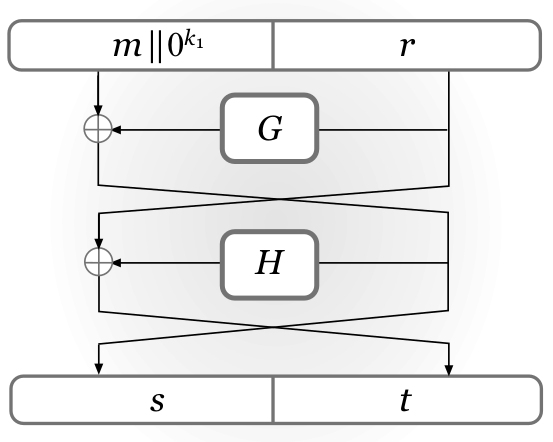

## RSA-OAEP (cont)
- Padding: $m:=m||0^{k_1};\ s:=m'\oplus G(r);\ t:= r \oplus H(s);\ \hat m := s||t$
- Inverse: $s||t:= \hat m;\ r:=H(s)\oplus t;\ m' := G(r) \oplus s$
- RSA-OAEP implementations also attacked by Menger at Crypto'91
  - Menger found it possible to distinguish when $\hat m \in \mathbb Z_N^*$ is too large or when the padded $m'$ does not have enough trailing $0$s.
  - The theoretical construction does not allow this, but timing reveals information about $m$

# RSA signatures

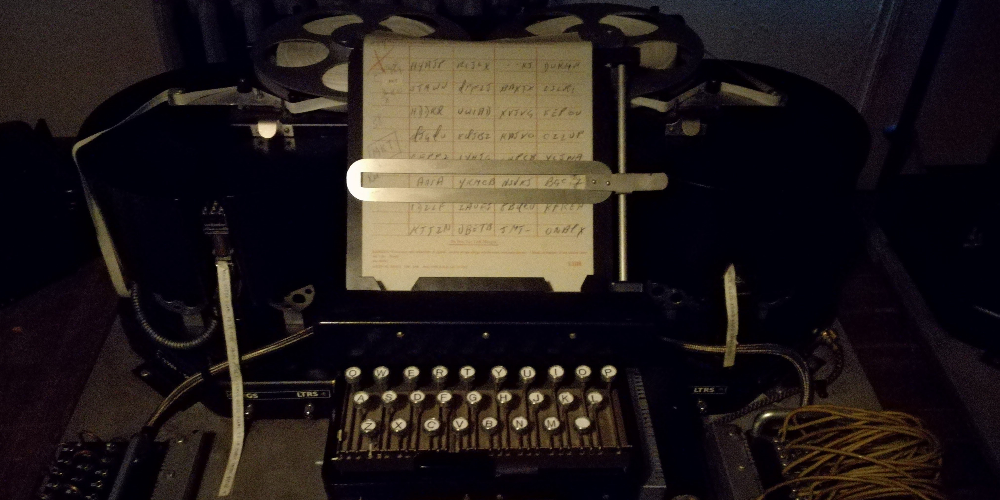

## Plain RSA signatures

- Use **GenRSA** as usual to get $\langle N, e, D \rangle$
- **Sign**: input private key $sk=\langle N,d\rangle$ and message $m$ to produce:

  $\sigma := m^d \mod N$
  
- **Verify**: input $\sigma$, public key $pk = \langle N, e\rangle$ and message $m$ to check:

  $m \overset{?}{=} \sigma^e \mod N$
  
- Verification always succeeds since

   $\sigma^e = (m^d)^e = m^{ed \mod \phi(N)} = m^1 = m$ $\mod N$

## Attacks on plain RSA signatures

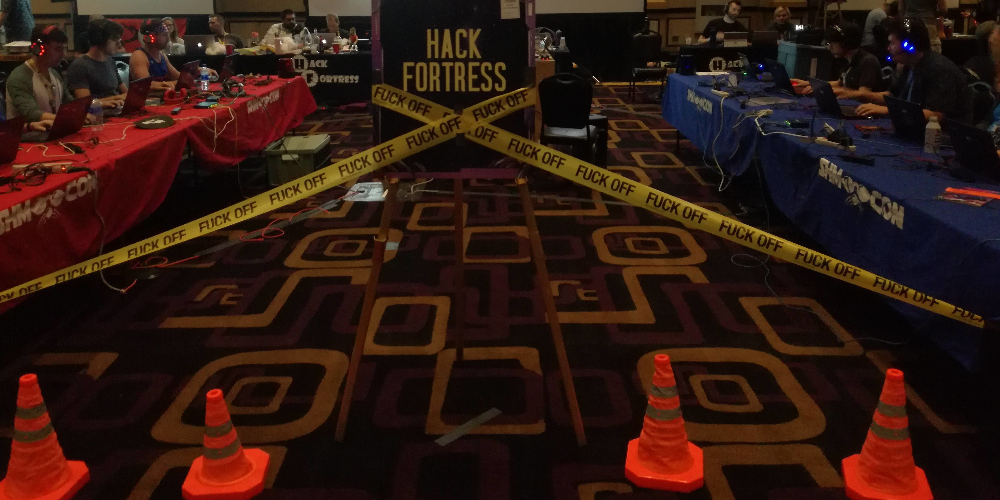

### No-message attack

- Forging a signature is really easy: choose a random $\sigma \in \mathbb Z_N^*$ and compute $m := \sigma^e \mod N$.
- It might seem just a theoretical attack, but if we only care to fix a few bits of the message, this is practical.

### Forging a signature on an arbitrary message

- If we can obtain *two* signatures from the signer, we can forge a signature for any message of our choice
- Choose $m \in \mathbb Z_N^*$ with two factors $m_1 \cdot m_2 = m$
- Obtain the signatures $\sigma_1, \sigma_2$ and compute $\sigma := \sigma_1 \cdot \sigma_2 \mod N$, which is a valid signature for $m$!

  $\sigma^e = (\sigma_1\cdot \sigma_2)^e = (m_1^d\cdot m_2^d)^e = m_1^{ed}\cdot m_2^{ed} = m \mod N$
  
- If we can obtain *more than two* signatures, the attack can be generalized

# RSA-FDH and PKCS \#1 v2.1

- Same trick as the other PKCS standards, set an encoding $\hat m$:

  $\hat m = H(m)$ for some hash function $H$

- **Sign**: $\sigma := \hat m^d \mod N$,  **Verify**: $\hat m \overset{?}{=} \sigma^e \mod N$
- *Hope* that the hash $H$ does not satisfy the relation $H(m) = H(m_1) \cdot H(m_2)$ if $m = m_1 \cdot m_2$
- Verified in the random oracle model, but not provable with real hash functions

# Secure multi-party computation

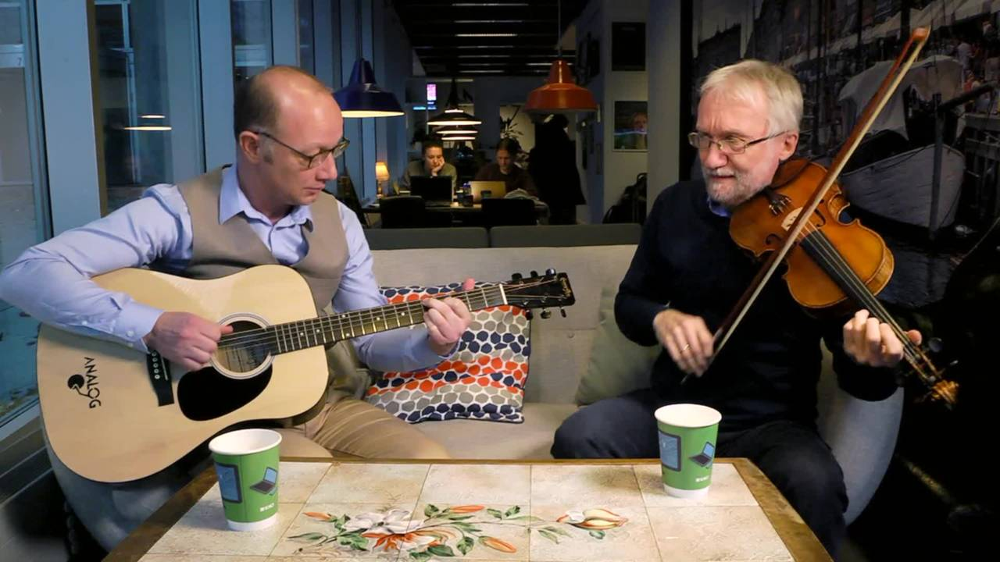

*<https://video.itu.dk/video/20232796/ivan-damgard-secure-multi-party-computation-1>

## Commitment schemes

A *commitment scheme* allows a Committer to "commit" to a message $m$ to a Verifier by sending a commitment value $com$ with these properties:
- *Hiding*: the commitment reveals nothing about $m$
- *Binding*: it is impossible for the committer to output a commitment $com$ that can "open" as two different messages $m, m'$

## Pedersen commitment

Recall ElGamal encryption: $c = (\alpha, \beta) = (g^r, m \cdot h^r)$ for some $x, r \overset{\$}{\leftarrow} \mathbb Z_q^*$, $h = g^x$. We can construct a commitment as follows:

- **Commit** inputs the message $m$, public key $k$, randomness $r$ and outputs $\beta'= g^m \cdot h^r$ (note slightly different than encryption)
- **Reveal** releases also $\alpha = g^r$ and $m$

### Hiding

Up until the reveal message, any value $m'$ is equally likely from the Verifier's perspective, assuming that $r$ is uniformly random

In fact, we know that for any $m, r$ and $m'$ there is an $r'$ such that:

- $r^{\prime} = \frac{m-m^{\prime}}{a} + r$ (because we have a cyclic group)

So until they get $\alpha = g^r$, the verifier knows nothing about $m$

### Binding

Note that it's computationally hard for the Committer to change its commitment to $m' \neq m$, as it would require to break the Computational Diffie-Hellman problem (CDH)

In fact, to compute $m'$ given a commitment to $m$, one needs to solve the following:

- find an $r'$ such that $g^m\cdot h^r = g^{m'}\cdot h^{r'}$

if we could solve that, we would have a solution for $\log_g(h)=\frac{m^{\prime}-m}{r-r^{\prime}}$

# 1-2 oblivious transfer

"The 1-out-of-2 oblivious transfer allows one party to transfer exactly one secret, out of two recognizable secrets, to his counterpart. The first (second) secret is received with probability one half, while the sender is ignorant of which secret has been received"

## $\textsf{OT}^1_2(M_0, M_1)$ implementation

- Sender chooses randomly a key pair $pk, sk$ and two random public messages $m_0, m_1$.

  Sender transmits $pk, m_0, m_1$
  
- Receiver chooses randomly a bit $r \in \{0,1\}$, a message $k$

  Transmits $q = Enc_{pk}(k) \oplus m_r$

- Sender computes $k'_i = Dec_{sk}(q \oplus m_i)$ for $i \in \{0,1\}$ and choses random $s\in\{0,1\}$

  Transmits $(M_0 \oplus k'_s, M_1 \oplus k'_{\bar s})$

### Why this works?

- If both parties follow the protocol, then $k_i' = Dec_{sk}(Enc_{pk}(k)+m_r+m_i)$ so for $i = r$ we have $k'_i = k$ and for $i \neq r$ we have random garbage. The receiver can compute $M_r$.
- If R has followed the protocol and has not received $M_{s \oplus r}$, then he knows he has been cheated by S.
- If both parties follow the protocol, then the only information S gets from R is $q = Enc_{pk}(k) \oplus m_r$

# That's all, folks

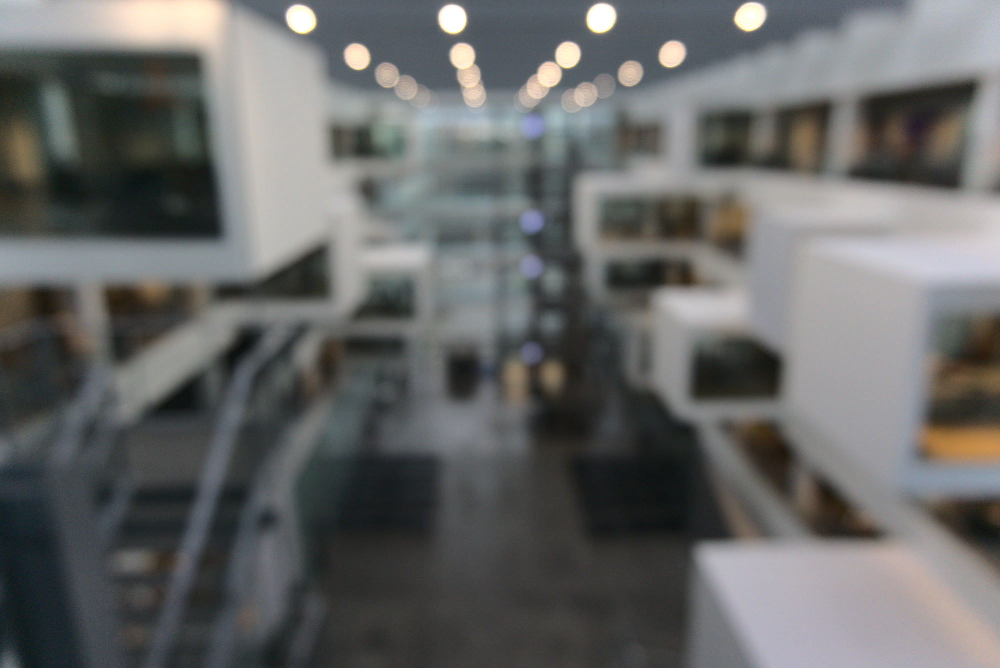